In [1]:
from torch.utils.data import Subset
from lightning import seed_everything
from siar.utils.entities import Task
from siar.data.datasets import SiarDatasetConfig
from siar.data.datamodules import SiarDataModule, SiarDataModuleConfig
import matplotlib.pyplot as plt
from unitorchplate.utils.constants import CHECKPOINT_DIR

# change that depending on the trained model
def reproduce_test_dataset(task: Task, return_sequence: bool) -> Subset:
    seed_everything(42, workers=True)  # use same seed as in training (42)
    dm = SiarDataModule(
        SiarDataModuleConfig(
            dataset_config=SiarDatasetConfig(
                return_sequence=return_sequence,
                gt_target=True if task == Task.ORIGINAL_RECONSTRUCTION else False,
                self_target=True if task == Task.SELF_RECONSTRUCTION else False,
                channel_first=True
            ),
            batch_size=1,
            num_workers=0,
        )
    )
    dm.prepare_data()
    dm.setup(stage="placeholder")
    return dm.test_dataset

test_dataset_example = reproduce_test_dataset(task=Task.ORIGINAL_RECONSTRUCTION, return_sequence=False)
# is a torch Subset object, therefore we can access the indices of the items in the whole dataset
test_dataset_example.indices[:10]

Global seed set to 42


Skipping .DS_Store
Skipping .gitkeep


[22470, 10360, 80140, 58000, 1150, 24760, 14690, 29560, 18630, 82910]

## Optional Plotting Tests

In [2]:
import torch


def subset_index_to_dataset_index(subset, subset_idx):
    return subset.indices[subset_idx]

example_subset_idx = 0
example_dataset_idx = subset_index_to_dataset_index(test_dataset_example, example_subset_idx)
item_obj = test_dataset_example.dataset.get_item_object(idx=example_dataset_idx)
print(f'Item {example_subset_idx} = {item_obj}')
assert torch.equal(test_dataset_example.dataset.load_image(item_obj.data), test_dataset_example[example_subset_idx][0])
sequence_obj = test_dataset_example.dataset.get_sequence_object(item_obj.sequence_id, by_idx=False)
print(sequence_obj)
x, y = test_dataset_example[example_subset_idx]  # the subset index 0 refers to dataset[example_dataset_idx:=22470]
x.shape

Item 0 = Item(id=8, sequence_id=3501, data='/Users/clemens/PycharmProjects/cvp2/datafiles/3501/8.png')
Sequence(idx=2247, id=3501, seq=[Item(id=8, sequence_id=3501, data='/Users/clemens/PycharmProjects/cvp2/datafiles/3501/8.png'), Item(id=9, sequence_id=3501, data='/Users/clemens/PycharmProjects/cvp2/datafiles/3501/9.png'), Item(id=10, sequence_id=3501, data='/Users/clemens/PycharmProjects/cvp2/datafiles/3501/10.png'), Item(id=4, sequence_id=3501, data='/Users/clemens/PycharmProjects/cvp2/datafiles/3501/4.png'), Item(id=5, sequence_id=3501, data='/Users/clemens/PycharmProjects/cvp2/datafiles/3501/5.png'), Item(id=7, sequence_id=3501, data='/Users/clemens/PycharmProjects/cvp2/datafiles/3501/7.png'), Item(id=6, sequence_id=3501, data='/Users/clemens/PycharmProjects/cvp2/datafiles/3501/6.png'), Item(id=2, sequence_id=3501, data='/Users/clemens/PycharmProjects/cvp2/datafiles/3501/2.png'), Item(id=3, sequence_id=3501, data='/Users/clemens/PycharmProjects/cvp2/datafiles/3501/3.png'), Item(id

torch.Size([3, 256, 256])

In [3]:
from dataclasses import dataclass


@dataclass
class Sample:
    sequence_id: int
    item_id: int
    rot_degree: float
    

def id_tuple(subset_idx: int | None = None, dataset_idx: int | None = None, degree: float = 0) -> Sample:
    if dataset_idx is None:
        dataset_idx = subset_index_to_dataset_index(test_dataset_example, subset_idx)
    item_obj = test_dataset_example.dataset.get_item_object(idx=dataset_idx)
    sequence_obj = test_dataset_example.dataset.get_sequence_object(item_obj.sequence_id, by_idx=False)
    return Sample(sequence_obj.id, item_obj.id, degree)
    
def translate_indices_to_id_tuple(idx: list[int]) -> list[tuple[int, int]]:
    samples = []
    for i, d in idx:
        sample = id_tuple(subset_idx=i, degree=d)
        samples.append(sample)
    return samples


# l = [94, 4044, 5507, 1407, 4210, 5308, 6138, 7802, 10251, 10617]
s = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
degrees = [0] * 10
samples = translate_indices_to_id_tuple(zip(s, degrees))
samples

[Sample(sequence_id=3501, item_id=8, rot_degree=0),
 Sample(sequence_id=13297, item_id=8, rot_degree=0),
 Sample(sequence_id=742, item_id=8, rot_degree=0),
 Sample(sequence_id=12462, item_id=8, rot_degree=0),
 Sample(sequence_id=9811, item_id=8, rot_degree=0),
 Sample(sequence_id=13689, item_id=8, rot_degree=0),
 Sample(sequence_id=12753, item_id=8, rot_degree=0),
 Sample(sequence_id=6088, item_id=8, rot_degree=0),
 Sample(sequence_id=2623, item_id=8, rot_degree=0),
 Sample(sequence_id=13834, item_id=8, rot_degree=0)]

In [4]:
selected_samples = [
    Sample(sequence_id=13689, item_id=8, rot_degree=90),
    Sample(sequence_id=6604, item_id=2, rot_degree=90),
    Sample(sequence_id=9811, item_id=8, rot_degree=0),
    Sample(sequence_id=8033, item_id=1, rot_degree=0),
    Sample(sequence_id=2268, item_id=2, rot_degree=0),
    Sample(sequence_id=742, item_id=4, rot_degree=90),
    Sample(sequence_id=3501, item_id=1, rot_degree=0),
    Sample(sequence_id=13834, item_id=8, rot_degree=90),
    Sample(sequence_id=2623, item_id=7, rot_degree=90),
    Sample(sequence_id=13834, item_id=9, rot_degree=90),
]
samples = selected_samples

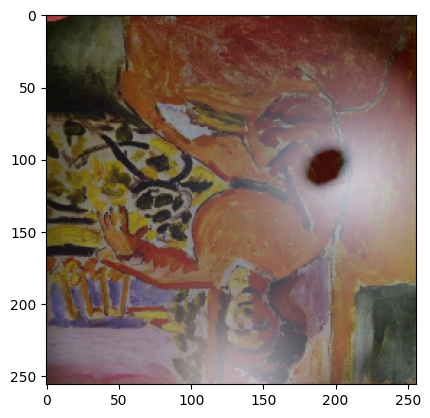

In [5]:
plt.imshow(test_dataset_example[94][0].permute(2,1,0))

## Plotting Code

In [6]:
from tqdm import tqdm
from torch import Tensor
from scipy import ndimage
import matplotlib.gridspec as gridspec


def get_model(cls, ckpt_path):
    model = cls.load_from_checkpoint(ckpt_path, map_location=torch.device('cpu'))
    model.eval()
    return model


def rotate(inputs, deg):
    if deg is None or deg == 0:
        return inputs
    return torch.from_numpy(ndimage.rotate(inputs, deg, reshape=False))


def prove_in_test_contained(test_dataset: Subset, x: Tensor, y: Tensor) -> bool:
    for tx, ty in test_dataset:
        bx = torch.equal(tx, x)
        by = torch.equal(ty, y)
        if bx and by:
            return True
    return False


def produce_image_grid(
        samples: list[Sample],
        model_cls: type,
        ckpt_path: str,
        task: Task,
        sequential: bool
):
    assert len(samples) % 2 == 0
    assert not sequential or task == Task.ORIGINAL_RECONSTRUCTION

    test_dataset = reproduce_test_dataset(
        task=task,
        return_sequence=sequential
    )
    
    model = get_model(
        cls=model_cls,
        ckpt_path=ckpt_path
    )
    
    px = 1/plt.rcParams['figure.dpi']
    tensor_resolution = 256
    image_inches = tensor_resolution * px
    if task == Task.SELF_RECONSTRUCTION:
        num_images_per_instance = 2
        title0 = 'In./Tar.'
    elif task == Task.ORIGINAL_RECONSTRUCTION:
        num_images_per_instance = 3 if not sequential else 12
        title0 = 'Input'
    else:
        raise ValueError()

    samples_on_x = 2 if not sequential else 6
    cols = num_images_per_instance * samples_on_x if not sequential else samples_on_x
    
    samples_on_y = len(samples) // samples_on_x if not sequential else 1
    rows = samples_on_y if not sequential else num_images_per_instance
    
    num_images_per_instance_in_row = num_images_per_instance if not sequential else 1
    figsize = (image_inches * cols, image_inches * rows)
    fig = plt.figure(layout='constrained', figsize=figsize)
    outer_gs = gridspec.GridSpec(1, samples_on_x, hspace=None, wspace=None, figure=fig)
    i = 0
    for sample_col in tqdm(range(samples_on_x)):
        gs = gridspec.GridSpecFromSubplotSpec(rows, num_images_per_instance_in_row, 
                                              subplot_spec=outer_gs[0, sample_col], hspace=None, wspace=None)
        x, y, recon = None, None, None
        for r in range(rows):
            sample = samples[i]
            sequence_obj = test_dataset.dataset.get_sequence_object(sample.sequence_id, by_idx=False)
            if sequential and task == Task.ORIGINAL_RECONSTRUCTION:
                if r < num_images_per_instance - 2:
                    item_obj = test_dataset.dataset.get_item_object(sequence_id=sample.sequence_id, item_id=sequence_obj.seq[r].id)
                if x is None or y is None:
                    x = torch.stack([test_dataset.dataset.load_image(it.data) for it in sequence_obj.seq])
                    y = test_dataset.dataset.load_image(sequence_obj.gt)
            elif not sequential and task == Task.ORIGINAL_RECONSTRUCTION:
                item_obj = test_dataset.dataset.get_item_object(sequence_id=sample.sequence_id, item_id=sample.item_id)
                x, y = test_dataset.dataset.load_image(item_obj.data), test_dataset.dataset.load_image(sequence_obj.gt)
            elif not sequential and task == Task.SELF_RECONSTRUCTION:
                item_obj = test_dataset.dataset.get_item_object(sequence_id=sample.sequence_id, item_id=sample.item_id)
                x, y = test_dataset.dataset.load_image(item_obj.data), test_dataset.dataset.load_image(item_obj.data)
            else:
                raise ValueError("Task not supported!")

            if not sequential or recon is None:
                if not prove_in_test_contained(test_dataset, x, y):
                    raise UserWarning(f"Given sample {sample} is not in the test set!")
                model_output = model(torch.unsqueeze(x, 0))
                recon = model_output['recon_x'].squeeze().permute(2, 1, 0).detach().numpy()
                
            ax1 = fig.add_subplot(gs[r, 0])
            if not sequential or r < num_images_per_instance - 2:
                xx = x if not sequential else x[r]
                ax1.imshow(rotate(xx.permute(2, 1, 0), sample.rot_degree))
                ax1.set_title(f'{title0} Seq. {sample.sequence_id}, Item {item_obj.id}', y=-0.15)
            elif r == num_images_per_instance - 2:
                ax1.imshow(rotate(recon, sample.rot_degree))
                ax1.set_title('Reconstruction', y=-0.15)
            elif r == num_images_per_instance - 1:
                ax1.imshow(rotate(y.permute(2, 1, 0), sample.rot_degree))
                ax1.set_title('Target', y=-0.15)
            ax1.invert_yaxis()
            ax1.axis('off')

            if not sequential:
                ax2 = fig.add_subplot(gs[r, 1])
                ax2.imshow(rotate(recon, sample.rot_degree))
                ax2.invert_yaxis()
                ax2.set_title('Reconstruction', y=-0.15)
                ax2.axis('off')

                if task == Task.ORIGINAL_RECONSTRUCTION:
                    ax3 = fig.add_subplot(gs[r, 2])
                    ax3.imshow(rotate(y.permute(2, 1, 0), sample.rot_degree))
                    ax3.invert_yaxis()
                    ax3.set_title('Target', y=-0.15)
                    ax3.axis('off')
            if not sequential:
                i += 1
        if sequential:
            i += 1
    fig.savefig(fname=f"{ckpt_path.split('.ckpt')[0]}.pdf")
    plt.show()

## VDVAE

Global seed set to 42


Skipping .DS_Store
Skipping .gitkeep


/Users/clemens/PycharmProjects/cvp2/venv/lib/python3.10/site-packages/lightning/pytorch/utilities/migration/utils.py:49: PossibleUserWarning: The loaded checkpoint was produced with Lightning v2.0.7, which is newer than your current Lightning version: v2.0.2
  rank_zero_warn(


No loss function provided. Maybe it is integrated as part of the architecture.


100%|██████████| 2/2 [01:53<00:00, 56.79s/it]


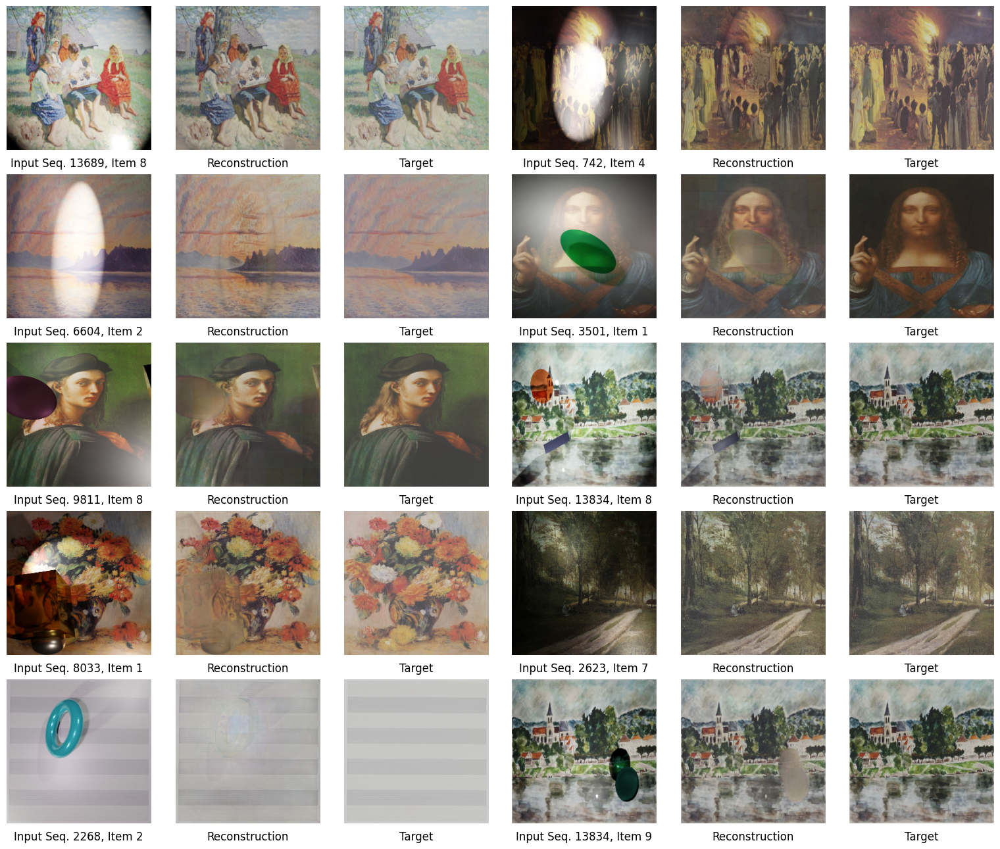

In [7]:
from siar.models.architectures.vdvae import VdVae

produce_image_grid(
    samples=samples,
    model_cls=VdVae,
    ckpt_path=f'{CHECKPOINT_DIR}/vdvae/original-recon/stellar-rain-26.ckpt',
    task=Task.ORIGINAL_RECONSTRUCTION,
    sequential=False
)

Global seed set to 42


Skipping .DS_Store
Skipping .gitkeep
No loss function provided. Maybe it is integrated as part of the architecture.


  0%|          | 0/2 [00:00<?, ?it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 50%|█████     | 1/2 [00:35<00:35, 35.06s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range

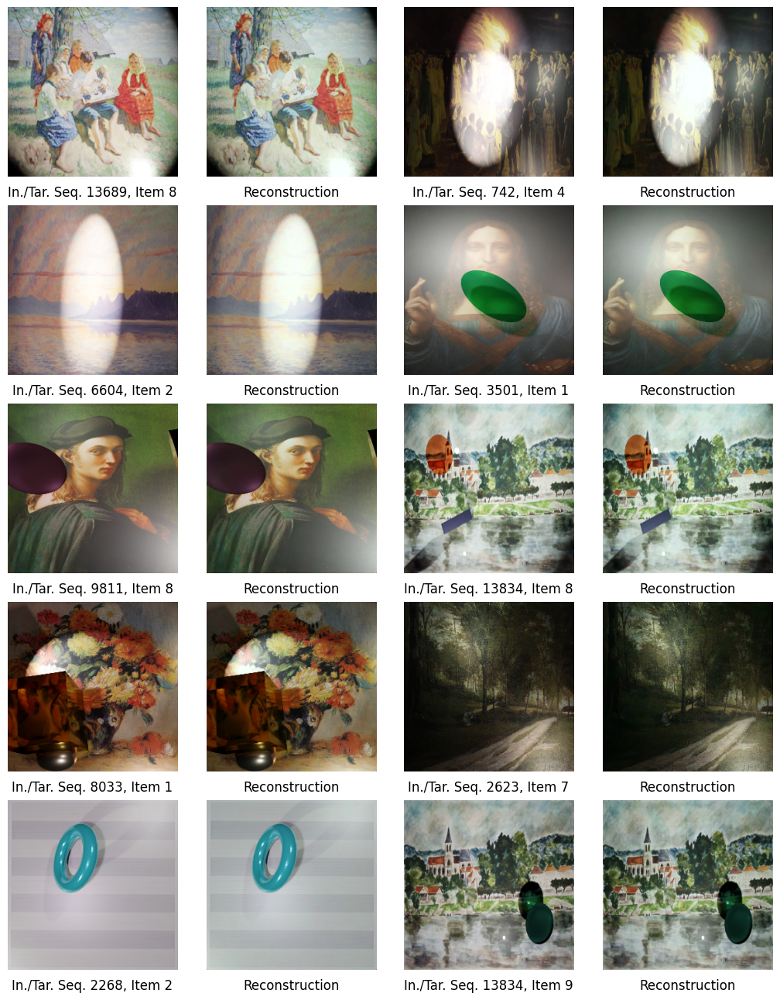

In [8]:
produce_image_grid(
    samples=samples,
    model_cls=VdVae,
    ckpt_path=f'{CHECKPOINT_DIR}/vdvae/self-recon/fine-shape-2.ckpt',
    task=Task.SELF_RECONSTRUCTION,
    sequential=False
)

Global seed set to 42


Skipping .DS_Store
Skipping .gitkeep


/Users/clemens/PycharmProjects/cvp2/venv/lib/python3.10/site-packages/lightning/pytorch/utilities/migration/utils.py:49: PossibleUserWarning: The loaded checkpoint was produced with Lightning v2.0.7, which is newer than your current Lightning version: v2.0.2
  rank_zero_warn(


No loss function provided. Maybe it is integrated as part of the architecture.


  0%|          | 0/6 [00:00<?, ?it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 17%|█▋        | 1/6 [00:03<00:16,  3.36s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range

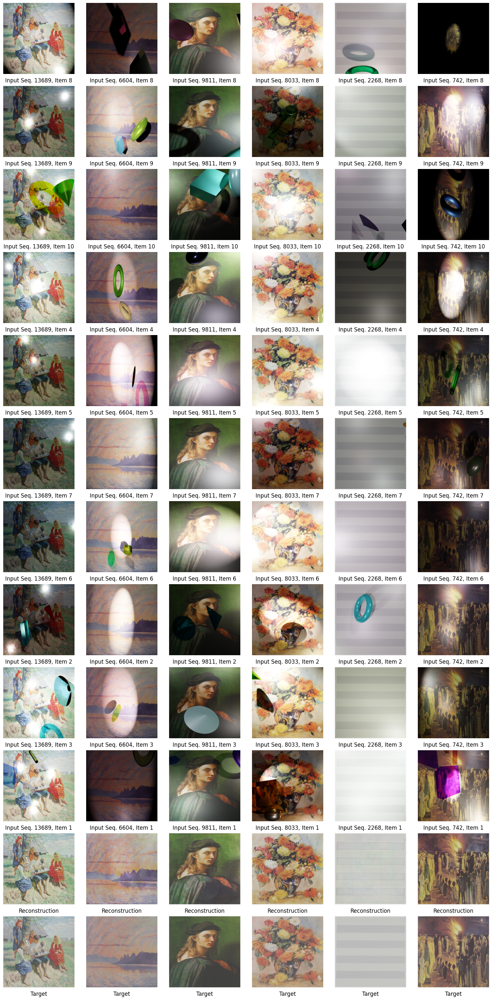

In [9]:
from siar.models.architectures.vdvae import SeqVdVae

produce_image_grid(
    samples=samples,
    model_cls=SeqVdVae,
    ckpt_path=f'{CHECKPOINT_DIR}/seq-vdvae/original-recon/soft-frog-11.ckpt',
    task=Task.ORIGINAL_RECONSTRUCTION,
    sequential=True
)

Global seed set to 42


Skipping .DS_Store
Skipping .gitkeep


/Users/clemens/PycharmProjects/cvp2/venv/lib/python3.10/site-packages/lightning/pytorch/utilities/migration/utils.py:49: PossibleUserWarning: The loaded checkpoint was produced with Lightning v2.0.7, which is newer than your current Lightning version: v2.0.2
  rank_zero_warn(


No loss function provided. Maybe it is integrated as part of the architecture.


100%|██████████| 2/2 [00:44<00:00, 22.45s/it]


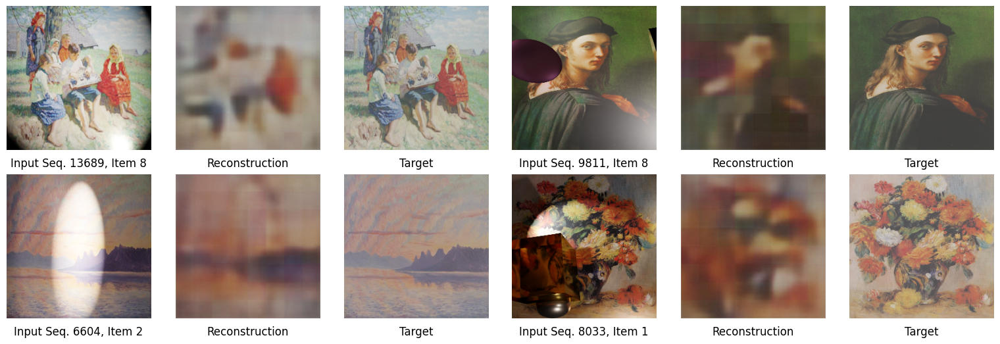

In [10]:
from siar.models.architectures.vdvae import VdVae

produce_image_grid(
    samples=samples[:4],
    model_cls=VdVae,
    ckpt_path=f'{CHECKPOINT_DIR}/vdvae/original-recon/autumn-brook-29-FTFFF.ckpt',
    task=Task.ORIGINAL_RECONSTRUCTION,
    sequential=False
)

Global seed set to 42


Skipping .DS_Store
Skipping .gitkeep


/Users/clemens/PycharmProjects/cvp2/venv/lib/python3.10/site-packages/lightning/pytorch/utilities/migration/utils.py:49: PossibleUserWarning: The loaded checkpoint was produced with Lightning v2.0.7, which is newer than your current Lightning version: v2.0.2
  rank_zero_warn(


No loss function provided. Maybe it is integrated as part of the architecture.


100%|██████████| 2/2 [00:43<00:00, 21.58s/it]


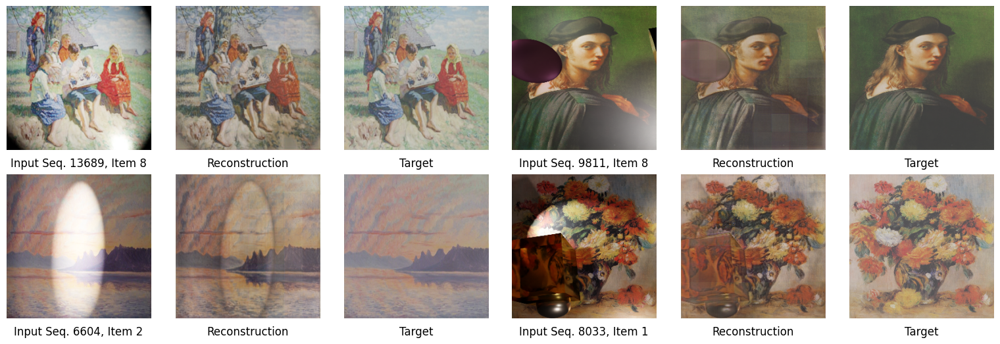

In [11]:
from siar.models.architectures.vdvae import VdVae

produce_image_grid(
    samples=samples[:4],
    model_cls=VdVae,
    ckpt_path=f'{CHECKPOINT_DIR}/vdvae/original-recon/leafy-frog-28-TFFFF.ckpt',
    task=Task.ORIGINAL_RECONSTRUCTION,
    sequential=False
)

## Simple ResVAE

Global seed set to 42


Skipping .DS_Store
Skipping .gitkeep
No loss function provided. Maybe it is integrated as part of the architecture.


100%|██████████| 2/2 [00:43<00:00, 21.64s/it]


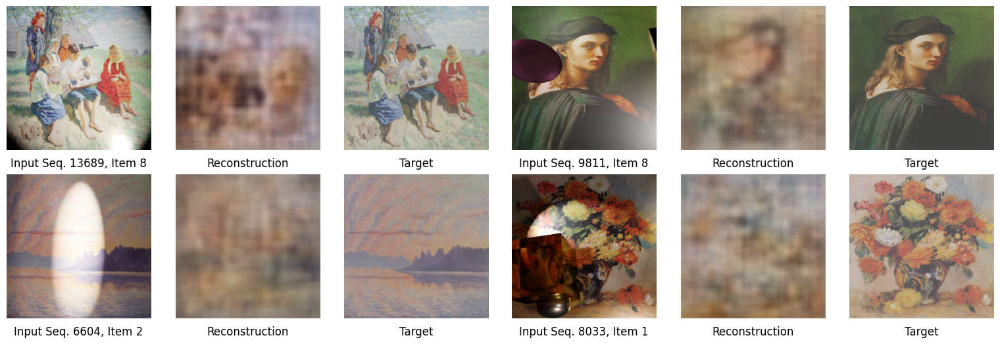

In [12]:
from siar.models.architectures.simple_res_vae import SimpleResVae

produce_image_grid(
    samples=samples[:4],
    model_cls=SimpleResVae,
    ckpt_path=f'{CHECKPOINT_DIR}/simple-res-vae/original-recon/curious-mountain-6_200epochs_2000latent.ckpt',
    task=Task.ORIGINAL_RECONSTRUCTION,
    sequential=False
)

Global seed set to 42


Skipping .DS_Store
Skipping .gitkeep
No loss function provided. Maybe it is integrated as part of the architecture.


100%|██████████| 2/2 [00:43<00:00, 21.78s/it]


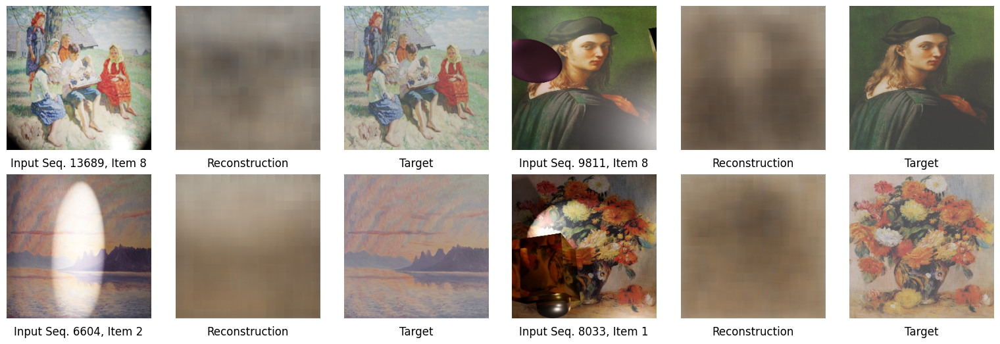

In [13]:
from siar.models.architectures.simple_res_vae import SimpleResVae

produce_image_grid(
    samples=samples[:4],
    model_cls=SimpleResVae,
    ckpt_path=f'{CHECKPOINT_DIR}/simple-res-vae/original-recon/sandy-fog-2_100epochs_10latent.ckpt',
    task=Task.ORIGINAL_RECONSTRUCTION,
    sequential=False
)

Global seed set to 42


Skipping .DS_Store
Skipping .gitkeep


/Users/clemens/PycharmProjects/cvp2/venv/lib/python3.10/site-packages/lightning/pytorch/utilities/migration/utils.py:49: PossibleUserWarning: The loaded checkpoint was produced with Lightning v2.0.7, which is newer than your current Lightning version: v2.0.2
  rank_zero_warn(


No loss function provided. Maybe it is integrated as part of the architecture.


  0%|          | 0/2 [00:00<?, ?it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
100%|██████████| 2/2 [00:20<00:00, 10.16s/it]


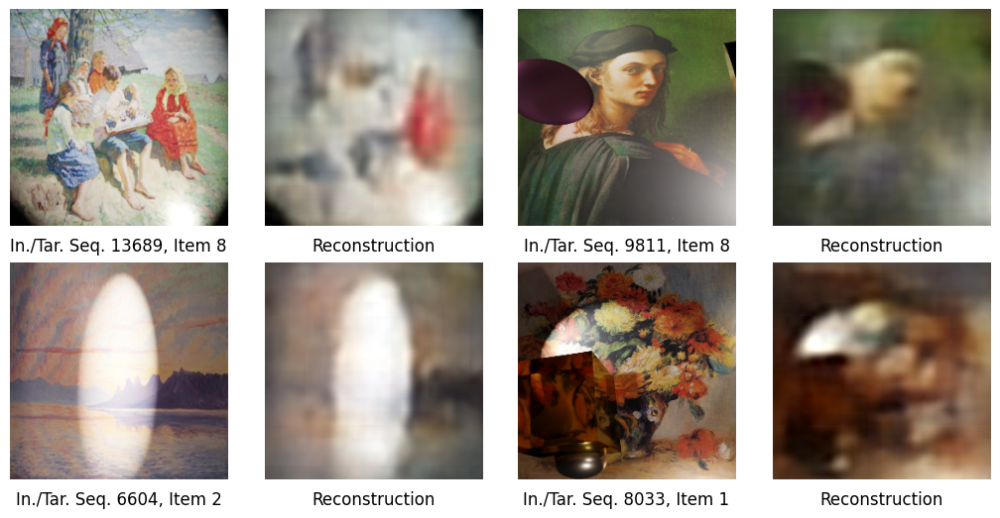

In [14]:
from siar.models.architectures.simple_res_vae import SimpleResVae

produce_image_grid(
    samples=samples[:4],
    model_cls=SimpleResVae,
    ckpt_path=f'{CHECKPOINT_DIR}/simple-res-vae/self-recon/rosa-plant-31.ckpt',
    task=Task.SELF_RECONSTRUCTION,
    sequential=False
)

## ResVae

Global seed set to 42


Skipping .DS_Store
Skipping .gitkeep


/Users/clemens/PycharmProjects/cvp2/venv/lib/python3.10/site-packages/lightning/pytorch/utilities/migration/utils.py:49: PossibleUserWarning: The loaded checkpoint was produced with Lightning v2.0.7, which is newer than your current Lightning version: v2.0.2
  rank_zero_warn(


No loss function provided. Maybe it is integrated as part of the architecture.


100%|██████████| 2/2 [00:36<00:00, 18.48s/it]


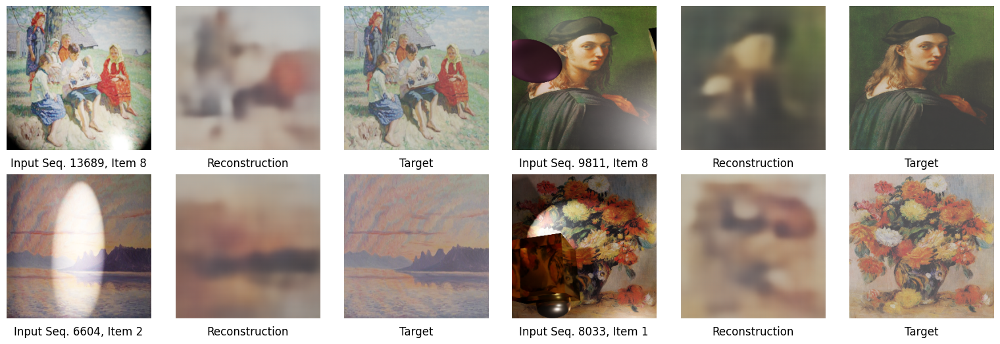

In [15]:
from siar.models.architectures.res_vae import ResVae

produce_image_grid(
    samples=samples[:4],
    model_cls=ResVae,
    ckpt_path=f'{CHECKPOINT_DIR}/res-vae/original-recon/dry-oath-11-latent2k.ckpt',
    task=Task.ORIGINAL_RECONSTRUCTION,
    sequential=False
)

Global seed set to 42


Skipping .DS_Store
Skipping .gitkeep


/Users/clemens/PycharmProjects/cvp2/venv/lib/python3.10/site-packages/lightning/pytorch/utilities/migration/utils.py:49: PossibleUserWarning: The loaded checkpoint was produced with Lightning v2.0.7, which is newer than your current Lightning version: v2.0.2
  rank_zero_warn(


No loss function provided. Maybe it is integrated as part of the architecture.


100%|██████████| 2/2 [00:37<00:00, 18.58s/it]


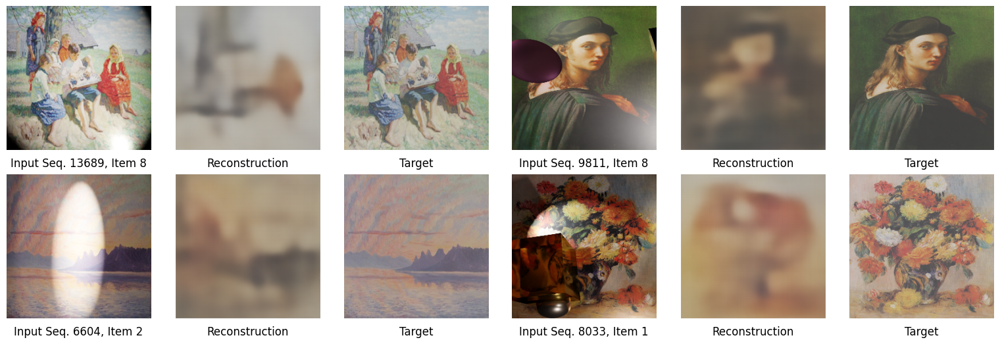

In [16]:
from siar.models.architectures.res_vae import ResVae

produce_image_grid(
    samples=samples[:4],
    model_cls=ResVae,
    ckpt_path=f'{CHECKPOINT_DIR}/res-vae/original-recon/golden-eon-10-latent4k.ckpt',
    task=Task.ORIGINAL_RECONSTRUCTION,
    sequential=False
)

Global seed set to 42


Skipping .DS_Store
Skipping .gitkeep


/Users/clemens/PycharmProjects/cvp2/venv/lib/python3.10/site-packages/lightning/pytorch/utilities/migration/utils.py:49: PossibleUserWarning: The loaded checkpoint was produced with Lightning v2.0.7, which is newer than your current Lightning version: v2.0.2
  rank_zero_warn(


No loss function provided. Maybe it is integrated as part of the architecture.


  0%|          | 0/2 [00:00<?, ?it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
100%|██████████| 2/2 [00:20<00:00, 10.11s/it]


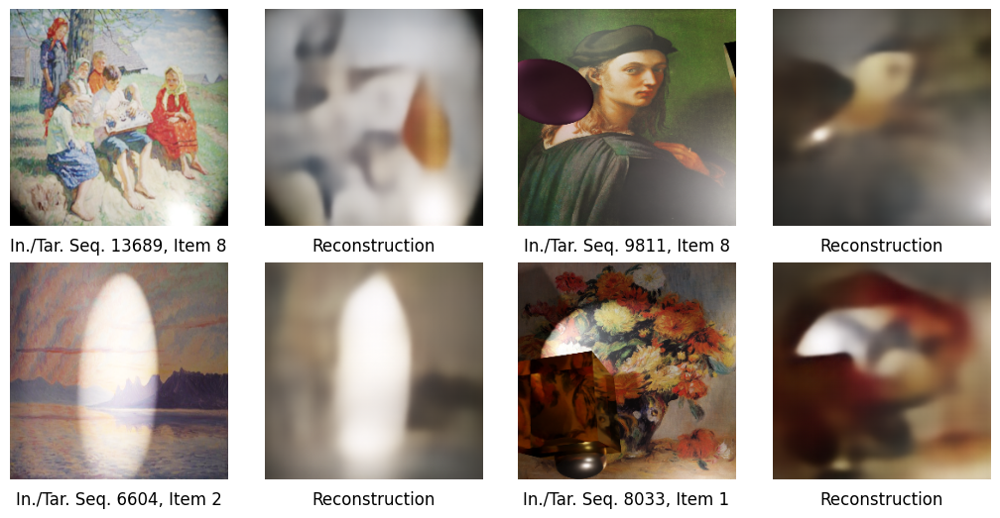

In [17]:
from siar.models.architectures.res_vae import ResVae

produce_image_grid(
    samples=samples[:4],
    model_cls=ResVae,
    ckpt_path=f'{CHECKPOINT_DIR}/res-vae/self-recon/solar-sun-1.ckpt',
    task=Task.SELF_RECONSTRUCTION,
    sequential=False
)

## NF-Vae

Global seed set to 42


Skipping .DS_Store
Skipping .gitkeep


/Users/clemens/PycharmProjects/cvp2/venv/lib/python3.10/site-packages/lightning/pytorch/utilities/migration/utils.py:49: PossibleUserWarning: The loaded checkpoint was produced with Lightning v2.0.7, which is newer than your current Lightning version: v2.0.2
  rank_zero_warn(


No loss function provided. Maybe it is integrated as part of the architecture.


  0%|          | 0/2 [00:00<?, ?it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
100%|██████████| 2/2 [01:33<00:00, 46.54s/it]


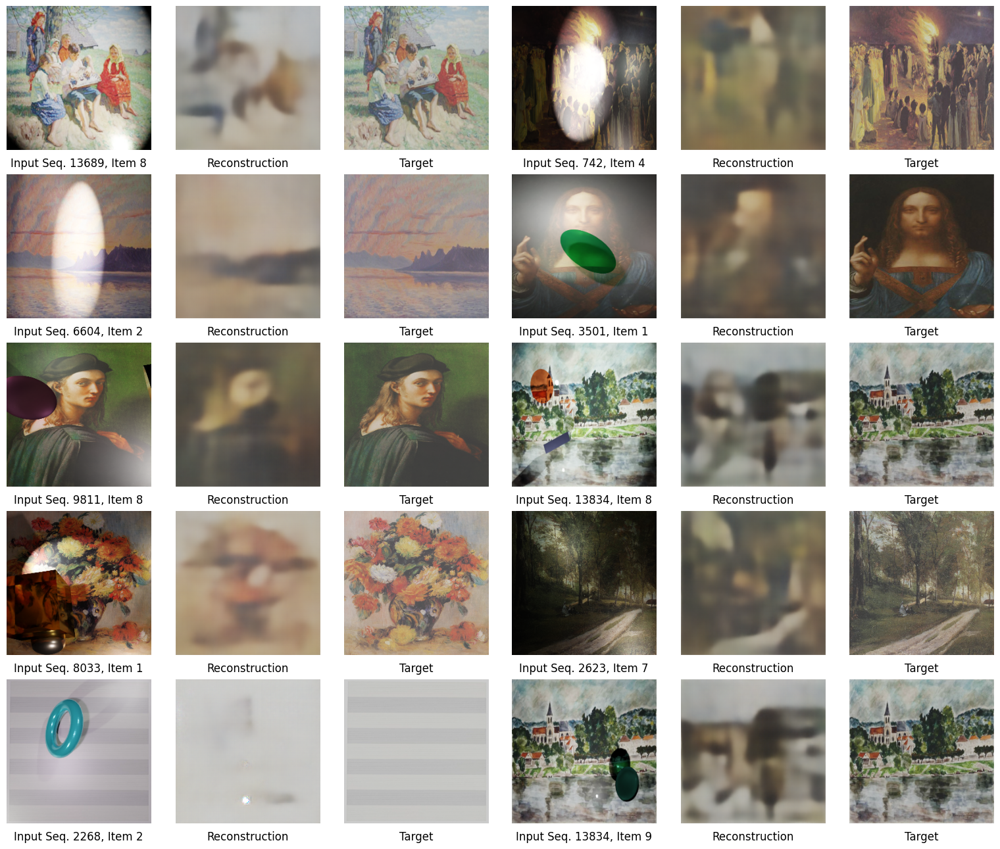

In [18]:
from siar.models.architectures.nf_vae import NfVae

produce_image_grid(
    samples=samples,
    model_cls=NfVae,
    ckpt_path=f'{CHECKPOINT_DIR}/nf-vae/original-recon/misunderstood-energy-53.ckpt',
    task=Task.ORIGINAL_RECONSTRUCTION,
    sequential=False
)

Global seed set to 42


Skipping .DS_Store
Skipping .gitkeep


/Users/clemens/PycharmProjects/cvp2/venv/lib/python3.10/site-packages/lightning/pytorch/utilities/migration/utils.py:49: PossibleUserWarning: The loaded checkpoint was produced with Lightning v2.0.7, which is newer than your current Lightning version: v2.0.2
  rank_zero_warn(


No loss function provided. Maybe it is integrated as part of the architecture.


  0%|          | 0/2 [00:00<?, ?it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 50%|█████     | 1/2 [00:28<00:28, 28.70s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
100%|██████████| 2/2 [00:49<00:00, 24.72s/it]


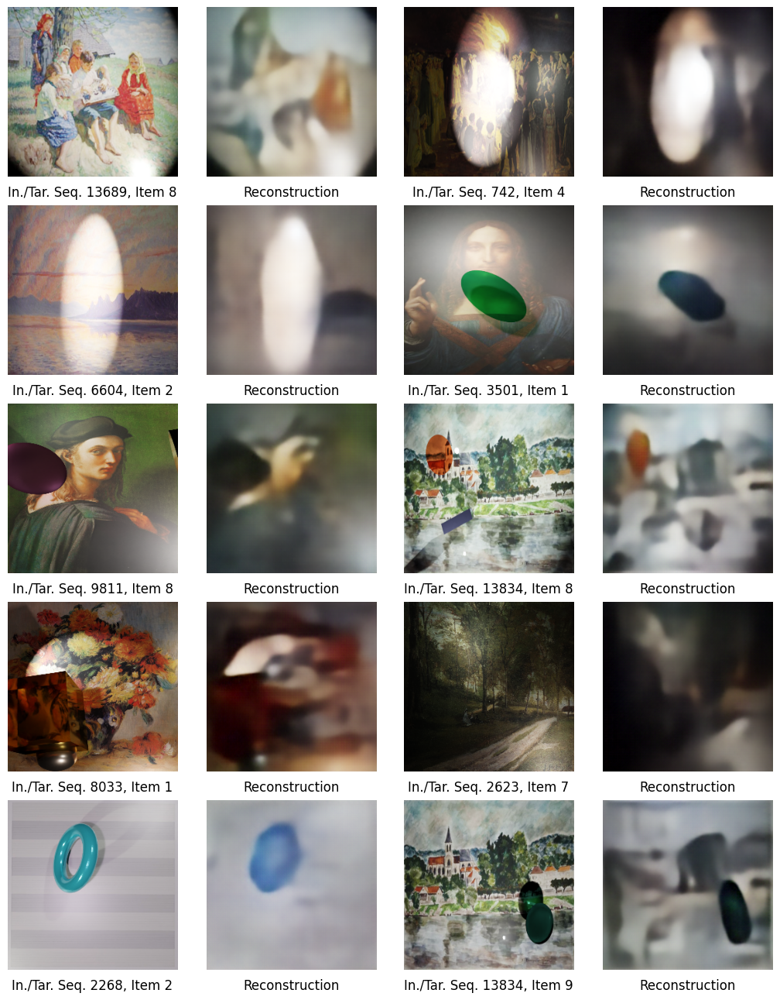

In [20]:
from siar.models.architectures.nf_vae import NfVae

produce_image_grid(
    samples=samples,
    model_cls=NfVae,
    ckpt_path=f'{CHECKPOINT_DIR}/nf-vae/self-recon/different-mountain-60.ckpt',
    task=Task.SELF_RECONSTRUCTION,
    sequential=False
)

## AdvVae

Global seed set to 42


Skipping .DS_Store
Skipping .gitkeep


/Users/clemens/PycharmProjects/cvp2/venv/lib/python3.10/site-packages/lightning/pytorch/utilities/migration/utils.py:49: PossibleUserWarning: The loaded checkpoint was produced with Lightning v2.0.7, which is newer than your current Lightning version: v2.0.2
  rank_zero_warn(


No loss function provided. Maybe it is integrated as part of the architecture.


100%|██████████| 2/2 [01:41<00:00, 50.74s/it]


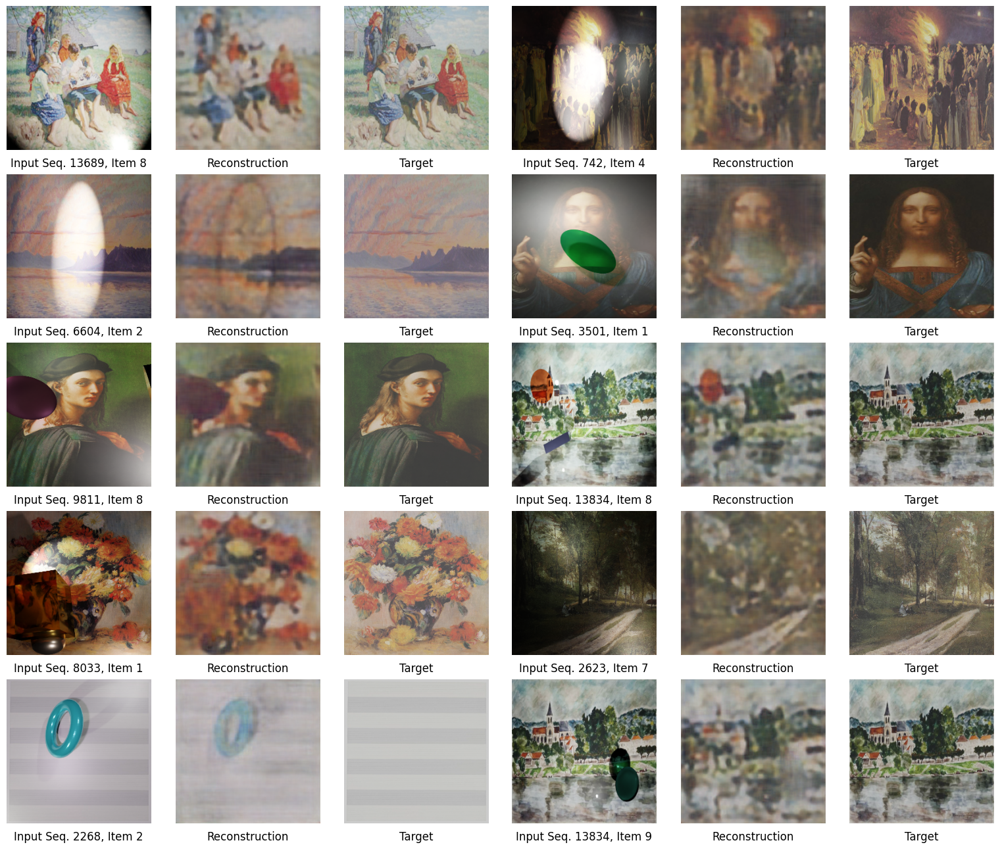

In [21]:
from siar.models.architectures.adv_vae import AdvVae

produce_image_grid(
    samples=samples,
    model_cls=AdvVae,
    ckpt_path=f'{CHECKPOINT_DIR}/adv-vae/original-recon/breezy-waterfall-27.ckpt',
    task=Task.ORIGINAL_RECONSTRUCTION,
    sequential=False
)

Global seed set to 42


Skipping .DS_Store
Skipping .gitkeep


/Users/clemens/PycharmProjects/cvp2/venv/lib/python3.10/site-packages/lightning/pytorch/utilities/migration/utils.py:49: PossibleUserWarning: The loaded checkpoint was produced with Lightning v2.0.7, which is newer than your current Lightning version: v2.0.2
  rank_zero_warn(


No loss function provided. Maybe it is integrated as part of the architecture.


  0%|          | 0/2 [00:00<?, ?it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
 50%|█████     | 1/2 [00:32<00:32, 32.08s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range

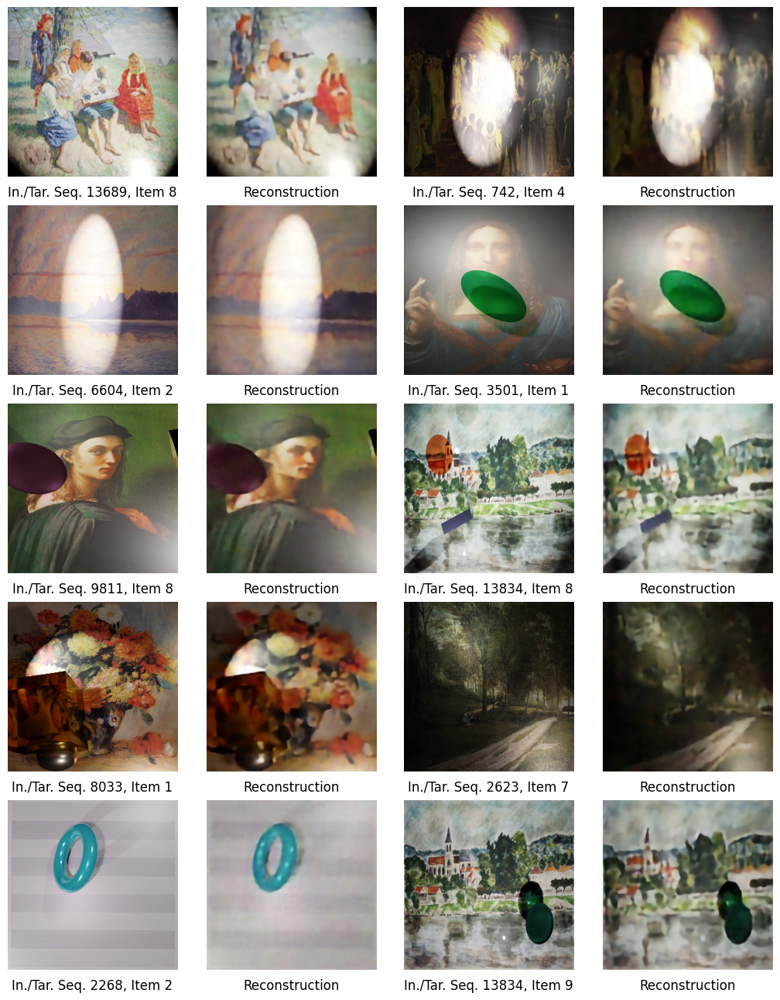

In [22]:
from siar.models.architectures.adv_vae import AdvVae

produce_image_grid(
    samples=samples,
    model_cls=AdvVae,
    ckpt_path=f'{CHECKPOINT_DIR}/adv-vae/self-recon/crimson-leaf-2.ckpt',
    task=Task.SELF_RECONSTRUCTION,
    sequential=False
)